In [1]:
## Tested using the following loaded modules
## module use /g/data/access/ngm/modules
## module load analysis3/21.10
import os, sys
workdir = "/g/data/xv83/users/bxn599/ACS/evaluation/"
os.chdir(workdir)
sys.path.append("./lib")
import glob
import xarray as xr
import numpy as np
import geopandas as gp
from datetime import datetime as dt
import lib_standards
import lib_spatial
import spatial_selection
import matplotlib as mpl
import matplotlib.pyplot as plt
import importlib
importlib.reload(lib_standards)
import warnings
warnings.filterwarnings('ignore')

font = {'size'   : 12}
mpl.rc('font', **font)

In [2]:
DATA_LOCATIONS = {
#    'AGCD': "/g/data/ia39/australian-climate-service/test-data/CORDEX-CMIP6/indices/AUS-r005/none/BOM-AGCD/historical/none/none/none/climdex",
#    'ERA5': "/g/data/ia39/australian-climate-service/test-data/CORDEX-CMIP6/indices/AUS-25/none/ECMWF-ERA5/historical/none/none/none/climdex",
#    'BARPA-R:ERA5': "/g/data/ia39/australian-climate-service/test-data/CORDEX-CMIP6/indices/AUS-15/BOM/ECMWF-ERA5/evaluation/none/BOM-BARPA-R/v1/climdex",
#    'CCAM:ERA5': "/g/data/ia39/australian-climate-service/test-data/CORDEX-CMIP6/indices/AUS-10/CSIRO/ECMWF-ERA5/evaluation/none/CSIRO-CCAM-2203/v1/climdex",
    'BARPA-R:ACCESS-CM2': "/g/data/xv83/users/bxn599/ACS/icclim_indices/AUS-15/BOM/CSIRO-BOM-ACCESS-CM2/ssp126/r4i1p1f1/BOM-BARPA-R/v1/climdex",
    'BARPA-R:ACCESS-ESM1-5': "/g/data/xv83/users/bxn599/ACS/icclim_indices/AUS-15/BOM/CSIRO-BOM-ACCESS-ESM1-5/ssp126/r6i1p1f1/BOM-BARPA-R/v1/climdex",
    'BARPA-R:EC-Earth3': "/g/data/xv83/users/bxn599/ACS/icclim_indices/AUS-15/BOM/EC-Earth-Consortium-EC-Earth3/ssp126/r1i1p1f1/BOM-BARPA-R/v1/climdex",
    'CCAM:NorESM2-MM': "/g/data/xv83/users/bxn599/ACS/icclim_indices/AUS-10/CSIRO/NCC-NorESM2-MM/ssp126/r1i1p1f1/CSIRO-CCAM-2203/v1/climdex",
    'CMIP6:ACCESS-CM2': "/g/data/xv83/users/bxn599/ACS/icclim_indices/GLOBAL-gn/none/CSIRO-ARCCSS-ACCESS-CM2/ssp126/r4i1p1f1/none/none/climdex",
    'CMIP6:ACCESS-ESM1-5': "/g/data/xv83/users/bxn599/ACS/icclim_indices/GLOBAL-gn/none/CSIRO-ARCCSS-ACCESS-CM2/ssp126/r4i1p1f1/none/none/climdex",
    'CMIP6:CESM2': "/g/data/xv83/users/bxn599/ACS/icclim_indices/GLOBAL-gn/none/NCAR-CESM2/ssp126/r11i1p1f1/none/none/climdex",
    'CMIP6:CMCC-ESM2': "/g/data/xv83/users/bxn599/ACS/icclim_indices/GLOBAL-gn/none/CMCC-CMCC-ESM2/ssp126/r1i1p1f1/none/none/climdex",
    'CMIP6:CNRM-ESM2-1': "/g/data/xv83/users/bxn599/ACS/icclim_indices/GLOBAL-gn/none/CNRM-CERFACS-CNRM-ESM2-1/ssp126/r1i1p1f2/none/none/climdex",
    'CMIP6:EC-Earth3': "/g/data/xv83/users/bxn599/ACS/icclim_indices/GLOBAL-gn/none/EC-Earth-Consortium-EC-Earth3/ssp126/r1i1p1f1/none/none/climdex",
    'CMIP6:NorESM2-MM': "/g/data/xv83/users/bxn599/ACS/icclim_indices/GLOBAL-gn/none/NCC-NorESM2-MM/ssp126/r1i1p1f1/none/none/climdex",
}
# Frequency of icclim indicator
FREQ = 'month'
# Data sources to consider here
SOURCES = ['BARPA-R:ACCESS-CM2', 'BARPA-R:ACCESS-ESM1-5', 'BARPA-R:EC-Earth3', 'CCAM:NorESM2-MM', 'CMIP6:ACCESS-CM2', \
           'CMIP6:ACCESS-ESM1-5', 'CMIP6:CESM2', 'CMIP6:CMCC-ESM2', 'CMIP6:CNRM-ESM2-1', 'CMIP6:EC-Earth3', 'CMIP6:NorESM2-MM']
# Grid to used as the reference grid to compute difference metrics
REFERENCE_GRID = 'CCAM:NorESM2-MM'
# "Truth" for compute difference metrics
REFERENCE = None
# Region of interest, as per defined in lib_standards.DOMAINS
REGION = 'Australia'  
# Period of interest, as per defined in lib_standards.PERIODS
PERIOD = 'FUTURE_WHOLE' 
SEASON='all'

In [3]:
def prepare_data(index, sources=SOURCES, freq=FREQ, region=REGION, period=PERIOD, reference_grid=REFERENCE_GRID, season=SEASON):
    """
    Reads in the icclim data and regrid to the reference grid.
    """
    # Load the data sources
    ds = {}
    for s in sources:
        #print("Reading the data {:}".format(s))
        fs = glob.glob(os.path.join(DATA_LOCATIONS[s], index, "{index}_*_{freq}_*.nc".format(index=index, freq=freq)))
        ds[s] = xr.open_dataset(fs[0])
        ds[s] = lib_standards.standardise_data(ds[s], region=region, period=period, season=season, compute=True)
        if (index == "DTR"):
            ds[s] = ds[s] + 273.15

    # Regrid to the REFERENCE_GRID
    ds_regrid = {}
    for s in sources:
        #print("Regridding the data {:} to reference grid of {:}".format(s, reference_grid))
        #ds_regrid[s] = lib_spatial.add_region_land_mask(ds[s], region)
        ds_regrid[s] = ds[s]
        if s == reference_grid:
            ds_regrid[s] = ds_regrid[s].compute()
        else:
            ds_regrid[s] = lib_standards.regrid(ds_regrid[s], ds[reference_grid]).compute()
#    print("Finished standardising data")
    return ds_regrid

# TX: Mean of daily maximum temperature

index = TX
index = TX:DJF
index = TX:MAM
index = TX:JJA
index = TX:SON


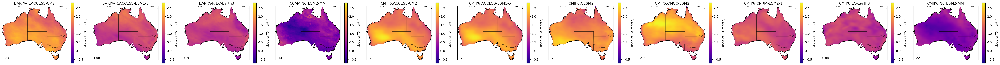

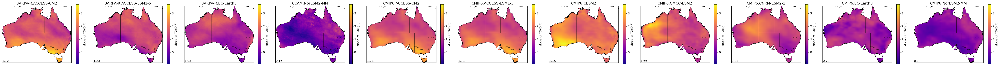

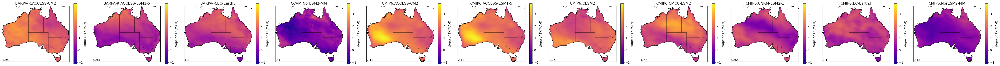

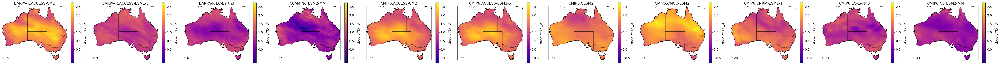

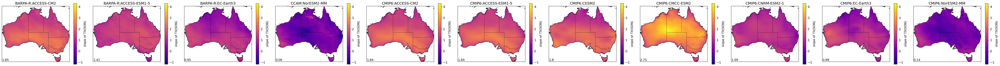

In [4]:
INDEXES = ['TX', 'TX:DJF', 'TX:MAM', 'TX:JJA', 'TX:SON']
for index in INDEXES:
    print("index = {:}".format(index))
    
    # check whether the index has special conditions
    index_condition = None
    if not ":" in index:
        # Prepare all the icclim data as per the setup in CONFIGURATIONS
        ds = prepare_data(index)
        clabel = "slope of {index}({freq})".format(index=index, freq=FREQ)
    else:
        index_condition = index.split(":")[1]
        index = index.split(":")[0]
        ds = prepare_data(index, season=index_condition)
        clabel = "slope of {index}({index_condition})".format(index=index, index_condition=index_condition)
    
    ds_target = {}
    flist = []
    for s in SOURCES:
        ds_target[s] = ds[s][index]
        
        ds_target[s] = lib_spatial.apply_region_mask(ds_target[s], 'Australia')
        ds_target[s] = lib_standards.compute_lr_slope(ds_target[s])
        
        # save min/max values into a flattened list to generate shared colourbar
        for sublist in ds_target[s].values:
            for item in sublist:
                flist.append(item)
                
    if index in ['TX']:
        cmap_variable = 'temp'
        cmap_class = 'hot'
    
    flistnp = np.array(flist)
    lib_standards.spatial_plot_trend(ds_target, flistnp, cmap_variable=cmap_variable, 
                                     cmap_class=cmap_class, clabel=clabel, include_area_avg=True)
    plt.tight_layout()
    plt.savefig("./figs/tx/ssp126_trend_tx_%s_%s.png"%(index,index_condition),dpi=300)

# TN: Mean of daily minimum temperature

index = TN
index = TN:DJF
index = TN:MAM
index = TN:JJA
index = TN:SON


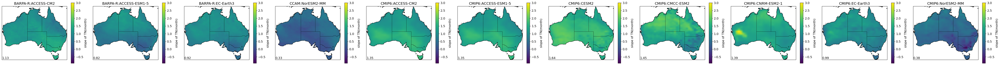

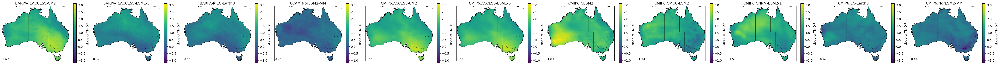

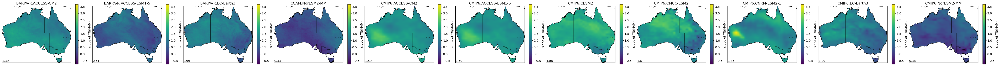

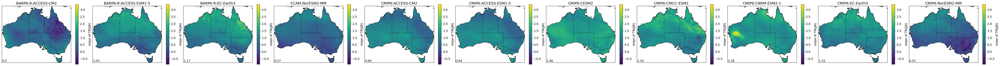

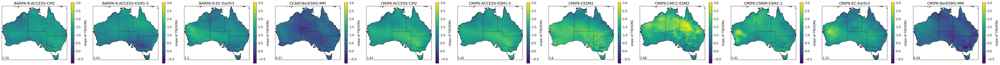

In [5]:
INDEXES = ['TN', 'TN:DJF', 'TN:MAM', 'TN:JJA', 'TN:SON']
for index in INDEXES:
    print("index = {:}".format(index))
    
    # check whether the index has special conditions
    index_condition = None
    if not ":" in index:
        # Prepare all the icclim data as per the setup in CONFIGURATIONS
        ds = prepare_data(index)
        clabel = "slope of {index}({freq})".format(index=index, freq=FREQ)
    else:
        index_condition = index.split(":")[1]
        index = index.split(":")[0]
        ds = prepare_data(index, season=index_condition)
        clabel = "slope of {index}({index_condition})".format(index=index, index_condition=index_condition)
    
    ds_target = {}
    flist = []
    for s in SOURCES:
        ds_target[s] = ds[s][index]
        
        ds_target[s] = lib_spatial.apply_region_mask(ds_target[s], 'Australia')
        ds_target[s] = lib_standards.compute_lr_slope(ds_target[s])

        # save min/max values into a flattened list to generate shared colourbar
        for sublist in ds_target[s].values:
            for item in sublist:
                flist.append(item)
                
    if index in ['TN']:
        cmap_variable = 'temp'
        cmap_class = 'cold'
    
    flistnp = np.array(flist)
    lib_standards.spatial_plot_trend(ds_target, flistnp, cmap_variable=cmap_variable, 
                                     cmap_class=cmap_class, clabel=clabel, include_area_avg=True)
    plt.tight_layout()
    plt.savefig("./figs/tn/ssp126_trend_tn_%s_%s.png"%(index,index_condition),dpi=300)

# TG: Mean of daily mean temperature

index = TG
index = TG:DJF
index = TG:MAM
index = TG:JJA
index = TG:SON


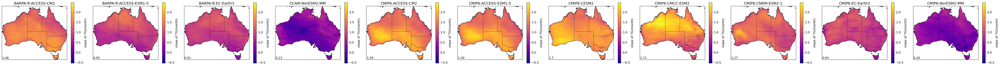

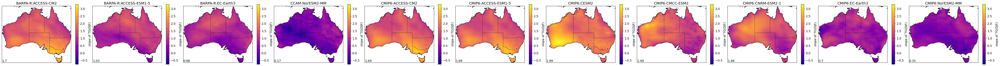

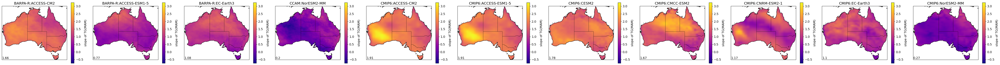

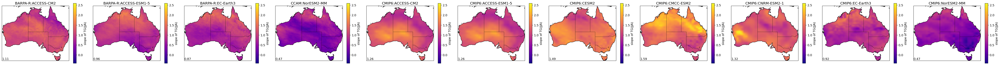

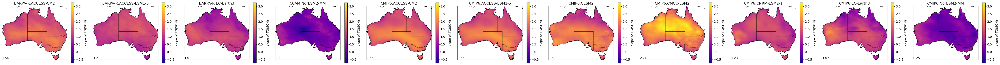

In [6]:
INDEXES = ['TG', 'TG:DJF', 'TG:MAM', 'TG:JJA', 'TG:SON']
for index in INDEXES:
    print("index = {:}".format(index))
    
    # check whether the index has special conditions
    index_condition = None
    if not ":" in index:
        # Prepare all the icclim data as per the setup in CONFIGURATIONS
        ds = prepare_data(index)
        clabel = "slope of {index}({freq})".format(index=index, freq=FREQ)
    else:
        index_condition = index.split(":")[1]
        index = index.split(":")[0]
        ds = prepare_data(index, season=index_condition)
        clabel = "slope of {index}({index_condition})".format(index=index, index_condition=index_condition)
    
    ds_target = {}
    flist = []
    for s in SOURCES:
        ds_target[s] = ds[s][index]
        
        ds_target[s] = lib_spatial.apply_region_mask(ds_target[s], 'Australia')
        ds_target[s] = lib_standards.compute_lr_slope(ds_target[s])
        
        # save min/max values into a flattened list to generate shared colourbar
        for sublist in ds_target[s].values:
            for item in sublist:
                flist.append(item)
                
    if index in ['TG']:
        cmap_variable = 'temp'
        cmap_class = 'hot'
    
    flistnp = np.array(flist)
    lib_standards.spatial_plot_trend(ds_target, flistnp,cmap_variable=cmap_variable, 
                                     cmap_class=cmap_class, clabel=clabel, include_area_avg=True)
    plt.tight_layout()
    plt.savefig("./figs/tg/ssp126_trend_tg_%s_%s.png"%(index,index_condition),dpi=300)

# DTR: Diurnal temperature range

index = DTR
False
index = DTR:DJF
False
index = DTR:MAM
False
index = DTR:JJA
False
index = DTR:SON
False


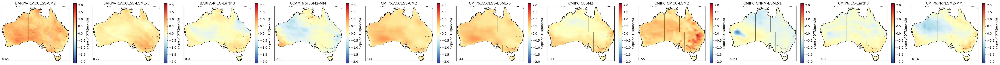

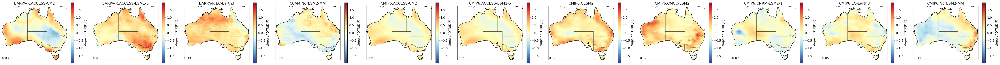

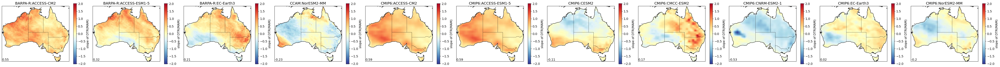

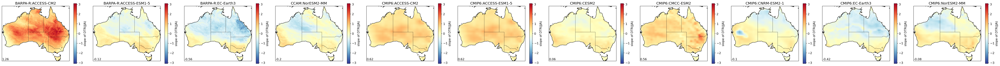

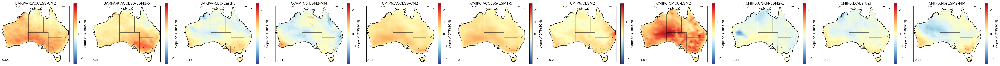

In [7]:
INDEXES = ['DTR', 'DTR:DJF', 'DTR:MAM', 'DTR:JJA', 'DTR:SON']
for index in INDEXES:
    print("index = {:}".format(index))
    
    # check whether the index has special conditions
    index_condition = None
    if not ":" in index:
        # Prepare all the icclim data as per the setup in CONFIGURATIONS
        ds = prepare_data(index)
        clabel = "slope of {index}({freq})".format(index=index, freq=FREQ)
    else:
        index_condition = index.split(":")[1]
        index = index.split(":")[0]
        ds = prepare_data(index, season=index_condition)
        clabel = "slope of {index}({index_condition})".format(index=index, index_condition=index_condition)
    
    ds_target = {}
    flist = []
    for s in SOURCES:
        ds_target[s] = ds[s][index]
        
        ds_target[s] = lib_spatial.apply_region_mask(ds_target[s], 'Australia')
        ds_target[s] = lib_standards.compute_lr_slope(ds_target[s])
        
        # save min/max values into a flattened list to generate shared colourbar
        for sublist in ds_target[s].values:
            for item in sublist:
                flist.append(item)
                
    if index in ['DTR']:
        cmap_variable = 'temp'
        cmap_class = 'hot_diff'
    
    flistnp = np.array(flist)
    lib_standards.spatial_plot_trend(ds_target, flistnp, cmap_variable=cmap_variable, cmap_class=cmap_class, 
                                     clabel=clabel, include_area_avg=True, centre_colourbar=True)
    plt.tight_layout()
    plt.savefig("./figs/temp_range/ssp126_trend_temp_range_%s_%s.png"%(index,index_condition),dpi=300)

# PRCPTOT: Total precipitation

index = PRCPTOT
False
index = PRCPTOT:DJF
False
index = PRCPTOT:MAM
False
index = PRCPTOT:JJA
False
index = PRCPTOT:SON
False


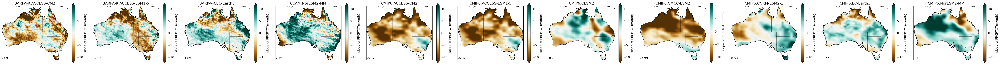

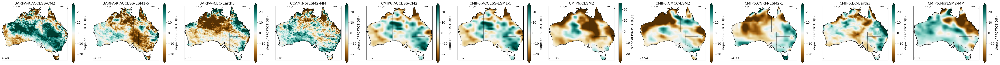

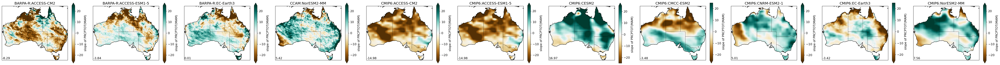

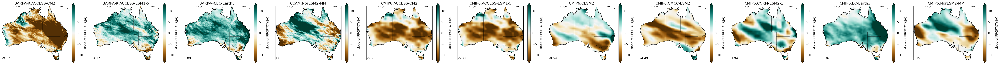

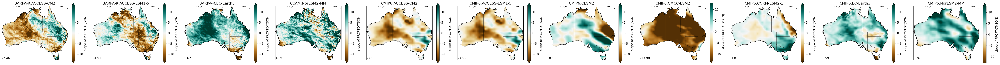

In [8]:
INDEXES = ['PRCPTOT', 'PRCPTOT:DJF', 'PRCPTOT:MAM', 'PRCPTOT:JJA', 'PRCPTOT:SON']
for index in INDEXES:
    print("index = {:}".format(index))
    
    # check whether the index has special conditions
    index_condition = None
    if not ":" in index:
        # Prepare all the icclim data as per the setup in CONFIGURATIONS
        ds = prepare_data(index)
        clabel = "slope of {index}({freq})".format(index=index, freq=FREQ)
    else:
        index_condition = index.split(":")[1]
        index = index.split(":")[0]
        ds = prepare_data(index, season=index_condition)
        clabel = "slope of {index}({index_condition})".format(index=index, index_condition=index_condition)
    
    ds_target = {}
    flist = []
    for s in SOURCES:
        ds_target[s] = ds[s][index]
        
        ds_target[s] = lib_spatial.apply_region_mask(ds_target[s], 'Australia')
#        if 'PRCPTOT' in index:
#            ds_target[s] = lib_spatial.apply_agcd_data_mask(ds_target[s])
        ds_target[s] = lib_standards.compute_lr_slope(ds_target[s])
            
        # save min/max values into a flattened list to generate shared colourbar
        for sublist in ds_target[s].values:
            for item in sublist:
                flist.append(item)
                
    if index in ['PRCPTOT']:
        cmap_variable = 'precip'
        cmap_class = 'wet_diff'
    
    flistnp = np.array(flist)
    lib_standards.spatial_plot_trend(ds_target, flistnp, cmap_variable=cmap_variable, cmap_class=cmap_class, 
                                     centre_colourbar=True, high_percentile=90, low_percentile=10, 
                                     clabel=clabel, include_area_avg=True)
    plt.tight_layout()
    plt.savefig("./figs/pr/ssp126_trend_pr_%s_%s.png"%(index,index_condition),dpi=300)